In [1]:
import os
import sys
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
drive_path = '/Volumes/Brain2016 1/'

In [3]:
from allensdk.core.brain_observatory_cache import BrainObservatoryCache

manifest_path = os.path.join(drive_path,'BrainObservatory','manifest.json')
boc = BrainObservatoryCache(manifest_file=manifest_path)

### get metrics for all cell_specimens in the dataset

In [4]:
#get cell metrics dataframe
cell_specimen_df = pd.DataFrame(boc.get_cell_specimens(ids=None,experiment_container_ids=None))
cell_specimen_df.head()

,area,cell_specimen_id,dsi_dg,experiment_container_id,imaging_depth,osi_dg,osi_sg,p_dg,p_ns,p_sg,...,pref_sf_sg,pref_tf_dg,time_to_peak_ns,time_to_peak_sg,tld1_id,tld1_name,tld2_id,tld2_name,tlr1_id,tlr1_name
0,VISpm,517394843,NaN,511498500,275,NaN,0.728590,NaN,2.644073e-05,0.000076,...,0.32,NaN,0.29925,0.19950,177839004,Cux2-CreERT2,177837320,Camk2a-tTA,265943423,Ai93(TITL-GCaMP6f)
1,VISpm,517394850,NaN,511498500,275,NaN,0.899272,NaN,3.568235e-04,0.056579,...,0.32,NaN,0.43225,0.56525,177839004,Cux2-CreERT2,177837320,Camk2a-tTA,265943423,Ai93(TITL-GCaMP6f)
2,VISpm,517394858,0.592835,511498500,275,1.150344,NaN,0.002900,NaN,NaN,...,NaN,8.0,NaN,NaN,177839004,Cux2-CreERT2,177837320,Camk2a-tTA,265943423,Ai93(TITL-GCaMP6f)
3,VISpm,517394866,0.599360,511498500,275,0.745139,NaN,0.000004,NaN,NaN,...,NaN,8.0,NaN,NaN,177839004,Cux2-CreERT2,177837320,Camk2a-tTA,265943423,Ai93(TITL-GCaMP6f)
4,VISpm,517394870,NaN,511498500,275,NaN,0.599881,NaN,3.334354e-07,0.067868,...,0.02,NaN,0.23275,0.39900,177839004,Cux2-CreERT2,177837320,Camk2a-tTA,265943423,Ai93(TITL-GCaMP6f)


### get experiment containers meeting certain criteria

In [5]:
#get experiment_containers meeting certain criteria
expts = boc.get_ophys_experiments(targeted_structures=['VISl'],cre_lines=['Cux2-CreERT2'],
                                  imaging_depths=[275],session_types=['three_session_B'])
expts = pd.DataFrame(expts)
print len(expts),'experiments meet these criteria'
expts.head()

3 experiments meet these criteria


,age_days,cre_line,experiment_container_id,id,imaging_depth,session_type,targeted_structure
0,101.0,Cux2-CreERT2,511510870,509799475,275,three_session_B,VISl
1,106.0,Cux2-CreERT2,511510848,507691834,275,three_session_B,VISl
2,108.0,Cux2-CreERT2,511510945,507691735,275,three_session_B,VISl


In [68]:
all_expts = boc.get_ophys_experiments()
all_expts = pd.DataFrame(all_expts)
all_expts.head()

,age_days,cre_line,experiment_container_id,id,imaging_depth,session_type,targeted_structure
0,132.0,Cux2-CreERT2,511510753,502066273,175,three_session_C,VISpm
1,116.0,Rorb-IRES2-Cre,511511001,506278598,275,three_session_B,VISpm
2,97.0,Rbp4-Cre,511510653,510529677,375,three_session_A,VISpm
3,116.0,Rorb-IRES2-Cre,511510729,504614224,275,three_session_C,VISl
4,123.0,Rorb-IRES2-Cre,511507144,501724959,275,three_session_A,VISp


In [66]:
expt_container_id = 511510753

In [70]:
# get session id for known experiment container & session type
all_expts[(all_expts.experiment_container_id==expt_container_id)&(all_expts.session_type=='three_session_C')].id.values[0]

502066273

In [6]:
#get experiment session id for the first experiment container
session_id = expts.id.values[0]
print session_id

509799475


### get data_set for one experiment session

In [7]:
#get data for a single experiment session
data_set = boc.get_ophys_experiment_data(ophys_experiment_id = session_id)

In [8]:
#what can you do with a data_set?
help(data_set)

Help on BrainObservatoryNwbDataSet in module allensdk.core.brain_observatory_nwb_data_set object:

class BrainObservatoryNwbDataSet(__builtin__.object)
 |  Methods defined here:
 |  
 |  __init__(self, nwb_file)
 |  
 |  get_cell_specimen_ids(self)
 |      Returns an array of cell IDs for all cells in the file
 |      
 |      Returns
 |      -------
 |      cell specimen IDs: list
 |  
 |  get_cell_specimen_indices(self, cell_specimen_ids)
 |      Given a list of cell specimen ids, return their index based on their order in this file.
 |      
 |      Parameters
 |      ----------
 |      cell_specimen_ids: list of cell specimen ids
 |  
 |  get_corrected_fluorescence_traces(self, cell_specimen_ids=None)
 |      Returns an array of neuropil-corrected fluorescence traces
 |      for all ROIs and the timestamps for each datapoint
 |      
 |      Parameters
 |      ----------
 |      cell_specimen_ids: list or array (optional)
 |          List of cell IDs to return traces for. If this i

In [9]:
#get all cell_specimen_ids in this session
cell_specimen_ids = data_set.get_cell_specimen_ids()
print cell_specimen_ids[:10]

[517488841 517492534 517492413 517492510 517484502 517490873 517490811
 517491599 517490830 517491111]


In [10]:
#get indices for cell_specimen_ids in this experiment
#use indices to index into traces & sweep_response
cell_specimen_idx = data_set.get_cell_specimen_indices(cell_specimen_ids)
print cell_specimen_idx[:10]

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]


In [11]:
#what stimuli are in this session?
data_set.list_stimuli()

[u'natural_movie_one', u'natural_scenes', u'spontaneous', u'static_gratings']

In [12]:
#get stimulus template (aka stimulus frames) for images, movies or locally sparse noise
ns_template = data_set.get_stimulus_template(stimulus_name='natural_scenes')
ns_template.shape

(118, 918, 1174)

In [13]:
#get stimulus table
stim_table = data_set.get_stimulus_table('natural_scenes')
stim_table.head()

,frame,start,end
0,20,16097,16104
1,72,16105,16111
2,19,16112,16119
3,101,16119,16127
4,41,16127,16134


### stimulus specific analysis - natural_scenes

In [14]:
#stimulus specific analysis
from allensdk.brain_observatory.natural_scenes import NaturalScenes
ns = NaturalScenes(data_set)

In [15]:
#what can get from the NaturalScenes object? 
#(hint: most things are already computed for you - do ns. tab complete to check)
help(ns)

Help on NaturalScenes in module allensdk.brain_observatory.natural_scenes object:

class NaturalScenes(allensdk.brain_observatory.stimulus_analysis.StimulusAnalysis)
 |  Perform tuning analysis specific to natural scenes stimulus.
 |  
 |  Parameters
 |  ----------
 |  data_set: BrainObservatoryNwbDataSet object
 |  
 |  Method resolution order:
 |      NaturalScenes
 |      allensdk.brain_observatory.stimulus_analysis.StimulusAnalysis
 |      __builtin__.object
 |  
 |  Methods defined here:
 |  
 |  __init__(self, data_set, **kwargs)
 |  
 |  get_peak(self)
 |      Computes metrics about peak response condition for each cell.
 |      
 |      Returns
 |      -------
 |      Pandas data frame with the following fields ('_ns' suffix is for
 |      natural scene):
 |          * scene_ns (scene number)
 |          * response_reliability_ns
 |          * peak_dff_ns (peak dF/F)
 |          * ptest_ns
 |          * p_run_ns
 |          * run_modulation_ns
 |          * time_to_peak_ns
 |  

In [16]:
#duration of each sweep in imaging frames
ns.sweeplength

6

In [17]:
#duration of window before and after stimulus included in sweep response
ns.interlength

24

In [18]:
#sweep_response table - dataframe of dF/F traces for every sweep (rows) for all cells (columns)
#trace includes interlength+sweeplength+interlength
sweep_response = ns.sweep_response

In [19]:
#check length of trace for one sweep from one cell in sweep_response table
#value should equal sweeplength+interlength*2
sweep_response.iloc[0][0].shape

(54,)

In [20]:
#mean_sweep_response - mean values of traces in sweep_response during stimulus window
#sweep (rows) by cells (columns)
mean_sweep_response = ns.mean_sweep_response 
mean_sweep_response.head()

,0,1,2,3,4,5,6,7,8,9,...,251,252,253,254,255,256,257,258,259,dx
0,12.418274,5.871527,5.599794,3.815869,0.526053,2.228843,6.028367,1.190621,1.674653,1.637678,...,4.048636,-13.329226,4.450078,1.508602,1.732629,3.184081,-1.651238,3.670427,4.011465,0.035566
1,3.007397,2.774787,5.359518,3.632038,7.841802,11.439992,13.729432,2.653048,5.658538,2.198213,...,1.932141,-11.852395,4.516848,3.014580,5.812439,10.940842,-1.666248,3.564546,6.499575,-0.191310
2,-3.345307,-0.579120,0.882733,-0.026673,3.049661,7.374558,11.693105,1.272825,6.266379,0.264762,...,3.115331,-11.673634,1.662271,2.039587,0.877686,15.653689,-3.988073,0.218606,57.703552,-0.158952
3,-8.496967,-1.653206,-5.240768,-2.810840,-2.951620,1.377301,-0.515395,5.196257,1.116533,-0.385984,...,-0.033214,-10.316792,-2.065676,4.824219,-5.383786,7.624096,-9.433590,-3.087440,102.370705,0.047478
4,-8.343891,-2.779307,-7.162851,-2.376591,-6.510853,-3.276185,-9.286360,3.195860,-6.714207,2.544935,...,1.025769,-5.917578,-1.153925,2.687200,-8.852141,-5.735470,-9.441893,-3.338022,8.743225,0.055797


In [21]:
#get mean response across conditions (conditions, cells, 3)
#for natural scenes, array is (#scenes, #cells, 3)
#last dimension is, for each condition: mean response, sem, p-value 
condition_response = ns.response
condition_response.shape

(119, 261, 3)

In [72]:
#mean response for all image conditions for cell 
cell = 0
mean_image_responses = condition_response[:,cell,0] #[image,cell,mean]

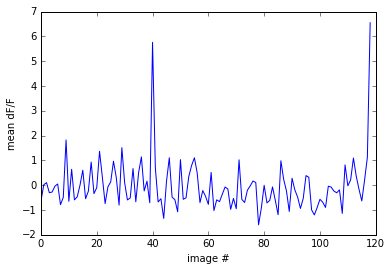

In [75]:
plt.plot(mean_image_responses)
plt.xlabel('image #')
plt.ylabel('mean dF/F')

### find pref image & plot mean response to that image

In [76]:
ns.peak

,scene_ns,response_reliability_ns,peak_dff_ns,ptest_ns,p_run_ns,run_modulation_ns,time_to_peak_ns,duration_ns,cell_specimen_id
0,117,24,6.55035,1.55578e-56,NaN,NaN,0.09978,0.19956,517488841
1,45,6,1.89426,1.12625e-10,NaN,NaN,0.36586,0.26608,517492534
2,1,20,2.9736,3.01897e-08,NaN,NaN,0.19956,0.1663,517492413
3,117,14,2.70644,7.42695e-05,NaN,NaN,0.1663,0.1663,517492510
4,43,12,3.06482,1.66149e-14,NaN,NaN,0.19956,0.1663,517484502
5,102,20,2.98395,1.35279e-09,NaN,NaN,0.39912,0.43238,517490873
6,101,20,7.48049,3.33763e-59,NaN,NaN,0.1663,0.29934,517490811
7,70,16,2.21563,8.92208e-12,NaN,NaN,0.1663,0.19956,517491599
8,72,16,3.37112,2.06102e-11,NaN,NaN,0.13304,0.19956,517490830
9,49,62,29.7162,1.73221e-89,NaN,NaN,0.26608,0.56542,517491111


In [23]:
cell = ns.peak[ns.peak.peak_dff_ns>=3].cell_specimen_id.values[0]
cell

517488841

In [24]:
pref_scene = ns.peak[ns.peak.cell_specimen_id==cell].scene_ns.values[0]
pref_scene

117

In [78]:
stim_table

,frame,start,end
0,20,16097,16104
1,72,16105,16111
2,19,16112,16119
3,101,16119,16127
4,41,16127,16134
5,4,16135,16142
6,76,16142,16149
7,110,16150,16157
8,73,16157,16164
9,30,16165,16172


In [25]:
pref_scene_sweeps = ns.stim_table[ns.stim_table.frame==pref_scene].index.values
pref_scene_sweeps

array([ 448,  550,  669,  691,  871,  920,  931, 1142, 1408, 1436, 1626,
       1754, 1759, 1817, 1953, 1962, 1968, 2371, 2472, 2483, 2742, 2759,
       2943, 3097, 3214, 3218, 3231, 3367, 3368, 3498, 3678, 3837, 3927,
       3980, 4209, 4404, 4411, 4455, 4581, 4721, 4742, 4904, 4960, 5112,
       5144, 5179, 5356, 5509, 5719, 5903])

In [27]:
#if the mean of the mean response to the preferred condition is > 5%
responsive_cells = ns.peak[ns.peak.peak_dff_ns>=5].cell_specimen_id.values
len(responsive_cells)

114

In [28]:
cell = responsive_cells[1]

In [81]:
responsive_cells

array([517488841, 517490811, 517491111, 517485261, 517485224, 517485015,
       517495454, 517495070, 517495040, 517495433, 517495377, 517493161,
       517489626, 517484971, 517489589, 517489890, 517488158, 517488227,
       517488260, 517485968, 517485931, 517485866, 517491336, 517491189,
       517488373, 517488433, 517488467, 517488495, 517488326, 517493541,
       517493567, 517492140, 517493138, 517492061, 517492120, 517492232,
       517490741, 517490098, 517490143, 517490729, 517491848, 517491800,
       517484640, 517494798, 517494823, 517494190, 517494847, 517495273,
       517495222, 517495097, 517487558, 517495092, 517493420, 517486804,
       517486896, 517493405, 517486864, 517486703, 517485823, 517494358,
       517488733, 517488399, 517486263, 517493866, 517493939, 517493094,
       517492975, 517492999, 517493024, 517495459, 517494257, 517493855,
       517492641, 517492666, 517486648, 517494980, 517494635, 517494623,
       517486925, 517487055, 517487327, 517495087, 

In [87]:
ns.sweep_response

,0,1,2,3,4,5,6,7,8,9,...,251,252,253,254,255,256,257,258,259,dx
0,"[-1.94758, 5.34551, -7.79307, -6.31825, -5.902...","[-1.22073, 6.07609, 3.6011, -0.586343, -4.6125...","[-6.81171, -1.99944, -4.51551, 3.29964, 3.9328...","[4.08312, 0.920343, -6.38704, -2.29568, -0.122...","[-7.10285, 5.91364, 1.36292, 5.68328, -5.69578...","[0.16315, 0.777447, 4.42445, 2.42621, 0.180256...","[-7.61757, 8.11989, 14.872, 4.38921, 4.38828, ...","[12.433, 7.49278, 0.82128, -3.46197, -4.27287,...","[5.77347, -0.338387, 2.71734, 2.52078, -4.9656...","[3.92834, -4.05453, -7.69603, 2.47396, -0.0443...",...,"[0.481284, 4.56877, 1.85661, -2.00066, 5.494, ...","[59.0988, 31.7139, 25.8324, 18.76, 20.1024, 14...","[6.35496, -2.10224, 2.61943, -4.41799, -1.6669...","[11.3251, 5.85825, -1.35386, -4.25452, -2.4378...","[5.04906, 0.608933, -3.9521, 4.84773, -2.14527...","[1.21, 8.6585, 11.5861, 1.85863, -0.235593, 6....","[4.67793, 10.5206, 3.24653, -0.841075, 0.68785...","[0.543523, -2.68103, -3.6315, 1.77475, 1.29664...","[7.51396, -0.0185549, -1.06181, 4.44582, 2.939...","[-1.49088013172, 0.216524004936, -1.0194904804..."
1,"[-6.13548, 1.34969, -2.52097, -3.43488, -12.55...","[-10.7321, -8.62597, -1.8966, -0.18307, -4.221...","[-5.86567, -2.75802, -0.0872672, 0.525773, 2.3...","[1.95643, -7.00914, -2.48961, -0.762111, -7.17...","[4.50615, -0.659871, 2.78189, -4.71057, 3.9578...","[4.43908, 1.44862, -2.97616, -3.69464, -2.7939...","[-5.00726, 8.60792, -5.14655, -3.97533, 2.7118...","[4.93197, 8.74515, 0.224185, 5.7066, -5.72439,...","[5.6783, -12.7926, 8.56911, -10.1864, -2.11745...","[-8.59802, -2.57829, -2.98581, 7.22049, -0.463...",...,"[-4.31356, 5.13026, -1.84991, 1.17657, -1.3695...","[5.40161, 2.61244, -1.67321, 0.695252, -4.6326...","[-4.64193, 1.48247, -1.19606, -1.55336, 2.4599...","[2.58169, 4.33584, -0.810635, 7.52771, -3.0467...","[1.8409, -3.07028, -0.691229, 0.669789, 2.8938...","[-1.25818, 2.20466, -6.30476, 4.91534, 2.14964...","[-5.34139, 5.46279, 4.30849, -5.01705, -2.4031...","[-5.36537, -2.70661, -3.05707, -1.15281, -1.32...","[-2.44569, 5.54898, -0.752473, -3.99157, -5.48...","[0.937478005886, -0.743196725845, -0.188038989..."
2,"[-14.4224, -7.99415, -0.197691, -4.61789, -7.6...","[-2.85463, 1.0246, -8.59485, -3.00901, -3.6952...","[-2.37821, -4.06234, -2.43385, -4.81591, -6.07...","[0.407898, -3.53902, -2.564, -8.81793, 0.81260...","[-1.68871, -6.60406, 1.07946, 9.72047, -11.440...","[-0.798786, -6.92833, -8.89431, -6.03618, 3.42...","[6.25138, -12.2392, -11.3203, -4.88491, -2.814...","[-4.35086, -5.15218, -2.46725, 2.97164, -4.320...","[-4.97411, -4.71988, 2.35952, -2.93437, 1.0743...","[2.26268, -3.47871, 7.62196, -0.368893, 0.1339...",...,"[-7.60797, 3.38722, -3.10009, -5.41068, -2.433...","[22.7333, 11.3174, 5.06967, 10.6558, 2.19465, ...","[0.766695, 1.39405, -7.22347, -7.9863, -0.7931...","[-5.35615, -4.51441, -0.0950634, 1.81501, -3.3...","[-1.19613, -7.69007, -2.55262, -5.0247, -10.53...","[-7.0487, -0.807822, -9.81205, -1.50439, -6.40...","[-5.67301, -0.702852, -1.28356, -3.50871, 9.11...","[-1.46077, -2.30755, -0.414276, 3.85337, 1.003...","[4.9646, -6.58895, 0.694668, -1.1346, -8.57896...","[1.67709207535, -2.31138634682, 0.943205714226..."
3,"[-9.20979, -2.71231, -7.0688, -9.68329, 5.7001...","[3.71675, -10.8783, -3.12515, 7.87871, 1.40239...","[-4.86866, -6.29253, -2.5338, -1.61846, 1.3137...","[-2.63392, 4.84992, -4.01604, -7.21063, -0.097...","[-6.03945, 0.278723, -8.95368, 1.65851, -0.367...","[-12.1133, 0.651598, -10.7266, -3.5222, -4.118...","[-11.6543, -7.61423, -3.94084, -7.01156, -9.55...","[-3.04906, -1.98575, -2.90343, -6.79601, 3.460...","[-5.52257, 0.296581, -9.36615, 5.4791, -0.8986...","[0.20678, 2.424, -9.40787, 0.652158, 2.63712, ...",...,"[-8.9325, -4.63538, 0.671792, -3.56075, -1.822...","[-2.35432, -4.79347, -2.84629, 4.95425, 14.321...","[-0.782853, -1.58707, -7.58305, 0.963795, 0.30...","[-5.65659, -1.67269, -2.7787, -6.9783, 4.36827...","[-3.73471, 2.38082, -8.79094, 0.35578, 0.90218...","[-12.0298, 

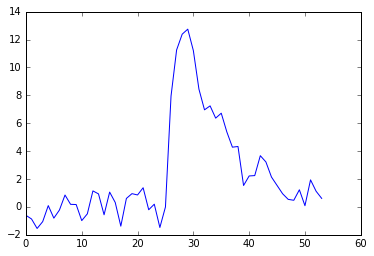

In [88]:
plt.plot(condition_mean)

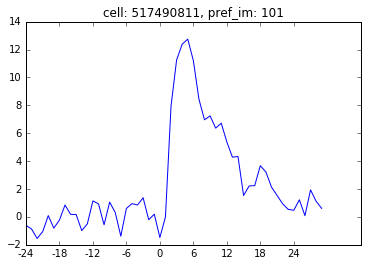

In [29]:
cell = responsive_cells[1]
cell_idx = np.where(ns.cell_id==cell)[0][0]
pref_scene = ns.peak[ns.peak.cell_specimen_id==cell].scene_ns.values[0]
pref_scene_sweeps = ns.stim_table[ns.stim_table.frame==pref_scene].index.values

condition_mean = ns.sweep_response[str(cell_idx)].iloc[pref_scene_sweeps].mean()
frames = ns.sweeplength+ns.interlength*2
t = np.arange(0,frames)
t_int = np.arange(0,frames,6)
t_int_ref = t_int - ns.interlength 

fig,ax = plt.subplots()
ax.plot(t,condition_mean)
ax.set_xticks(t_int);
ax.set_xticklabels(t_int_ref);
# ax.set_xlabel('time after stimulus onset')
# ax.set_ylabel('dF/F')
ax.set_title('cell: '+str(cell)+', pref_im: '+str(pref_scene))

### make it a function & plot for all 'responsive' cells

In [30]:
def plot_pref_condition_response(ns,cell_specimen_id):
    pref_scene = ns.peak[ns.peak.cell_specimen_id==cell_specimen_id].scene_ns.values[0]
    pref_scene_sweeps = ns.stim_table[ns.stim_table.frame==pref_scene].index.values
#     cell_idx = data_set.get_cell_specimen_indices([cell])[0]
    cell_idx = np.where(ns.cell_id==cell_specimen_id)[0][0]

    condition_mean = ns.sweep_response[str(cell_idx)].iloc[pref_scene_sweeps].mean()
    frames = ns.sweeplength+ns.interlength*2
    t = np.arange(0,frames)
    t_int = np.arange(0,frames,6)
    t_int_ref = t_int - ns.interlength 

    fig,ax = plt.subplots()
    ax.plot(t,condition_mean)
    ax.set_xticks(t_int);
    ax.set_xticklabels(t_int_ref/30.);
    ax.set_xlabel('time after stimulus onset')
    ax.set_ylabel('dF/F')
    ax.set_title('cell: '+str(cell)+', pref_im: '+str(pref_scene))

In [39]:
images = data_set.get_stimulus_template('natural_scenes')

In [89]:
images.shape

(118, 918, 1174)

In [46]:
def plot_pref_condition_response(ns,cell_specimen_id,images):
    pref_scene = ns.peak[ns.peak.cell_specimen_id==cell_specimen_id].scene_ns.values[0]
    pref_scene_sweeps = ns.stim_table[ns.stim_table.frame==pref_scene].index.values
#     cell_idx = data_set.get_cell_specimen_indices([cell])[0]
    cell_idx = np.where(ns.cell_id==cell_specimen_id)[0][0]

    condition_mean = ns.sweep_response[str(cell_idx)].iloc[pref_scene_sweeps].mean()
    frames = ns.sweeplength+ns.interlength*2
    t = np.arange(0,frames)
    t_int = np.arange(0,frames,6)
    t_int_ref = t_int - ns.interlength 

    fig,ax = plt.subplots(1,2,figsize=(12,4))
    ax = ax.ravel()
    ax[0].plot(t,condition_mean)
    ax[0].set_xticks(t_int);
    ax[0].set_xticklabels(t_int_ref/30.);
    ax[0].set_xlabel('time after stimulus onset')
    ax[0].set_ylabel('dF/F')
    ax[0].set_title('cell: '+str(cell)+', pref_im: '+str(pref_scene))
    
    ax[1].imshow(images[pref_scene,:,:],cmap='gray')

ERROR! Session/line number was not unique in database. History logging moved to new session 30


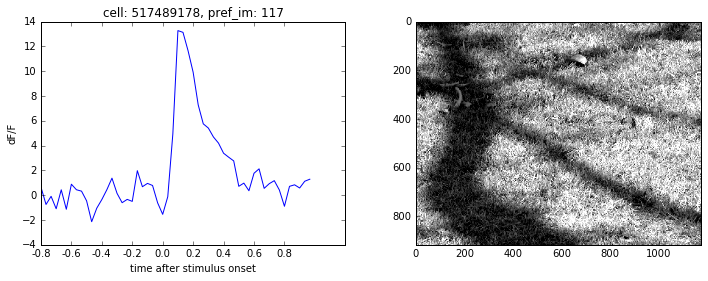

In [47]:
plot_pref_condition_response(ns,responsive_cells[0],images)

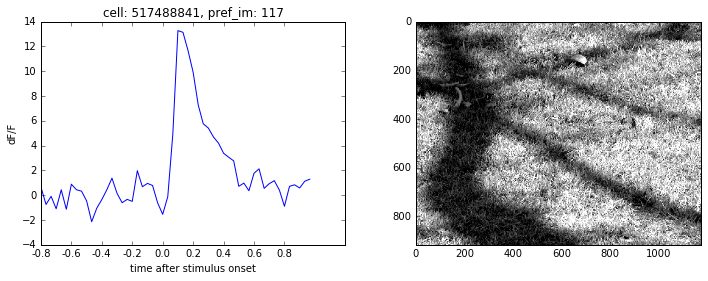

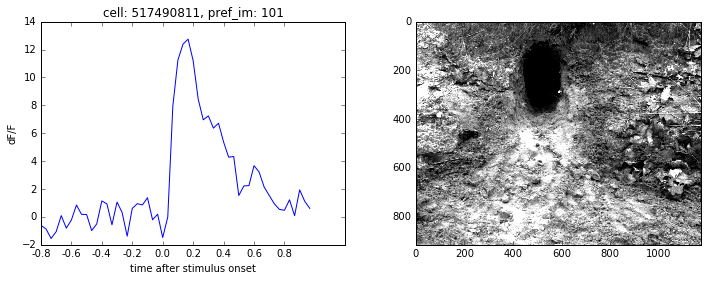

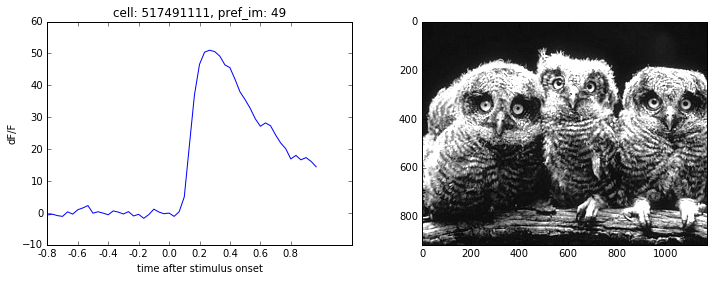

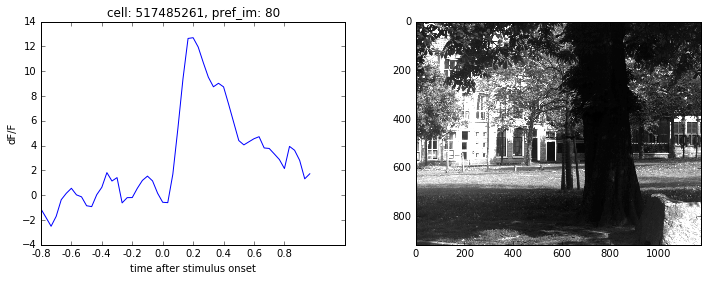

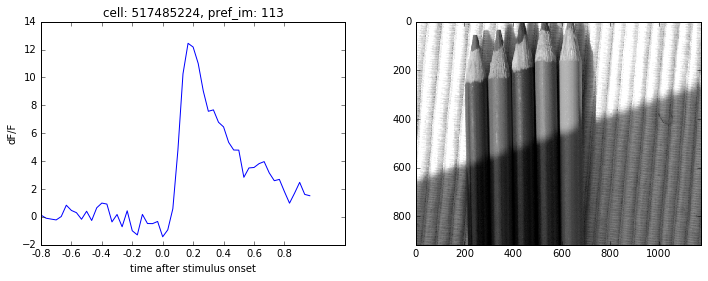

...

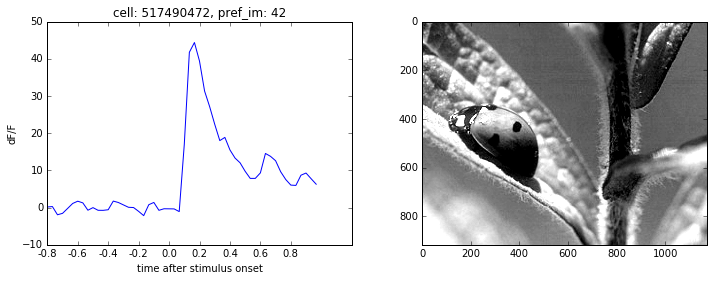

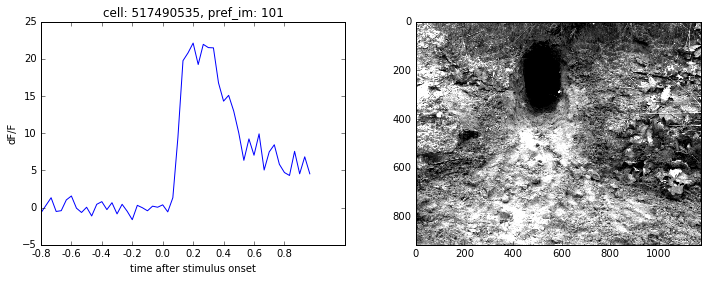

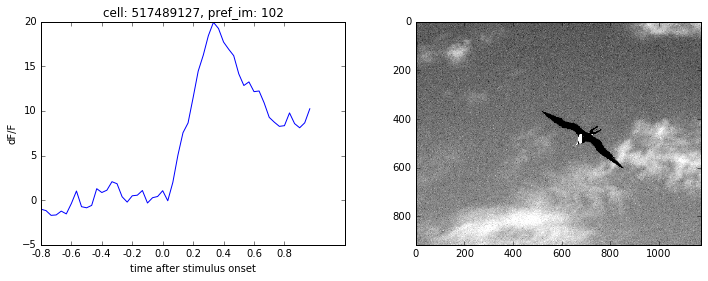

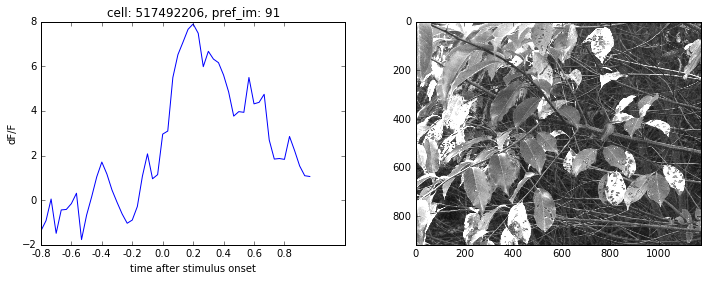

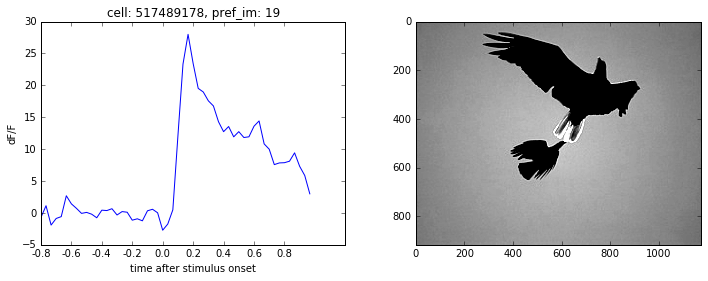

In [48]:
for cell in responsive_cells: 
    plot_pref_condition_response(ns,cell,images)

In [49]:
stim_table.head()

,frame,start,end
0,20,16097,16104
1,72,16105,16111
2,19,16112,16119
3,101,16119,16127
4,41,16127,16134


### get traces & image sequence for natural scenes portion of session 

In [51]:
timestamps,traces = data_set.get_dff_traces(cell_specimen_ids=responsive_cells)

In [52]:
frames_arr = np.empty(0)
images_arr = np.empty(0)
for sweep in range(len(stim_table)):
    start = stim_table.iloc[sweep].start
    end = stim_table.iloc[sweep].end
    frames = np.arange(start,end)
    frames_arr = np.hstack((frames_arr,frames))
    image = stim_table.iloc[sweep].frame
    for i in range(len(frames)):
        images_arr = np.hstack((images_arr,image))

In [53]:
traces_arr = np.empty((traces.shape[0],frames_arr.shape[0]))
for t in range(traces.shape[0]): 
    trace = np.empty(0)
    for sweep in range(len(stim_table)):
        start = stim_table.iloc[sweep].start
        end = stim_table.iloc[sweep].end
        tmp = traces[t,start:end]
        trace = np.hstack((trace,tmp))
    traces_arr[t,:] = trace

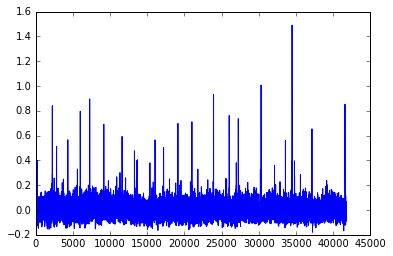

In [99]:
plt.plot(traces_arr[1,:])

In [102]:
thresh_inds = np.where(traces_arr[cell_num,:]>=0.3)[0]
thresh_inds = thresh_inds - 6

In [374]:
thresh_vals = traces_arr[cell_num][thresh_inds]

In [375]:
thresh_images = images_arr[thresh_inds]

In [376]:
img_stack = np.empty((thresh_images.shape[0],images[0,:,:].shape[0],images[0,:,:].shape[1]))
for i,img in enumerate(thresh_images):
    img_stack[i,:,:] = images[img,:,:]

/Users/marinag/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:3: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  app.launch_new_instance()


In [ ]:
mean_image = np.mean(img_stack,axis=0)

In [ ]:
plt.imshow(mean_image,cmap='gray')
plt.colorbar()

In [377]:
weighted_mean_image = np.average(img_stack,axis=0,weights=thresh_vals)

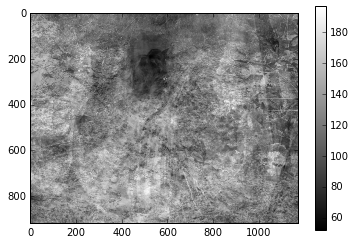

In [378]:
plt.imshow(weighted_mean_image,cmap='gray')
plt.colorbar()

### put it in a function and plot

In [147]:
def plot_mean_image(cell_specimen_id,ns,images,images_arr,traces_arr,thresh=0.3,weighted=False):
    cell_idx = np.where(ns.cell_id==cell_specimen_id)[0][0]
    thresh_inds = np.where(traces_arr[cell_idx,:]>=thresh)[0]
    thresh_inds = thresh_inds - 6
    thresh_vals = traces_arr[cell_idx][thresh_inds]
    thresh_images = images_arr[thresh_inds]
    n_images = len(np.unique(thresh_images))
    img_stack = np.empty((thresh_images.shape[0],images[0,:,:].shape[0],images[0,:,:].shape[1]))
    for i,img in enumerate(thresh_images):
        img_stack[i,:,:] = images[img,:,:]
    if weighted: 
        mean_image = np.average(img_stack,axis=0,weights=thresh_vals)
    else: 
        mean_image = np.mean(img_stack,axis=0)
    fig,ax=plt.subplots()
    ax.imshow(mean_image,cmap='gray')
    if weighted:
        ax.set_title('cell '+str(cell_specimen_id)+', weighted mean of '+str(n_images)+' images')
    else:
        ax.set_title('cell '+str(cell_specimen_id)+', mean of '+str(n_images)+' images')


/Users/marinag/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:10: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


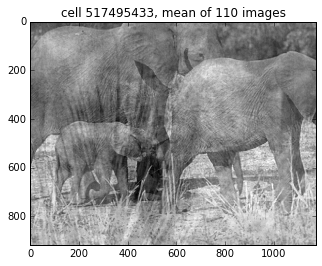

In [149]:
plot_mean_image(responsive_cells[9],ns,images,images_arr,traces_arr,thresh=0.3,weighted=True)

/Users/marinag/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:10: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


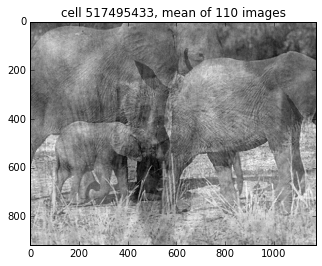

In [150]:
plot_mean_image(responsive_cells[9],ns,images,images_arr,traces_arr,thresh=0.3,weighted=False)

### batch processing 

In [156]:
#processing on all traces
def get_ns_response_arrays(data_set):
    timestamps,traces = data_set.get_dff_traces(cell_specimen_ids=responsive_cells)

    frames_arr = np.empty(0)
    images_arr = np.empty(0)
    for sweep in range(len(stim_table)):
        start = stim_table.iloc[sweep].start
        end = stim_table.iloc[sweep].end
        frames = np.arange(start,end)
        frames_arr = np.hstack((frames_arr,frames))
        image = stim_table.iloc[sweep].frame
        for i in range(len(frames)):
            images_arr = np.hstack((images_arr,image))

    traces_arr = np.empty((traces.shape[0],frames_arr.shape[0]))
    for t in range(traces.shape[0]): 
        trace = np.empty(0)
        for sweep in range(len(stim_table)):
            start = stim_table.iloc[sweep].start
            end = stim_table.iloc[sweep].end
            tmp = traces[t,start:end]
            trace = np.hstack((trace,tmp))
        traces_arr[t,:] = trace

    return frames_arr, images_arr, traces_arr     

In [ ]:
frames_arr, images_arr, traces_arr = get_ns_response_arrays(data_set)
images = data_set.get_stimulus_template('natural_images')

In [192]:
def plot_ns_summary(cell_specimen_id,ns,images,frames_arr,images_arr,traces_arr,thresh=0.5,weighted=False): 
        
    pref_scene = ns.peak[ns.peak.cell_specimen_id==cell_specimen_id].scene_ns.values[0]
    pref_scene_sweeps = ns.stim_table[ns.stim_table.frame==pref_scene].index.values
    #     cell_idx = data_set.get_cell_specimen_indices([cell])[0]
    cell_idx = np.where(ns.cell_id==cell_specimen_id)[0][0]

    condition_mean = ns.sweep_response[str(cell_idx)].iloc[pref_scene_sweeps].mean()
    frames = ns.sweeplength+ns.interlength*2
    t = np.arange(0,frames)
    t_int = np.arange(0,frames,6)
    t_int_ref = t_int - ns.interlength 

    cell_idx = np.where(ns.cell_id==cell_specimen_id)[0][0]
    thresh_inds = np.where(traces_arr[cell_idx,:]>=thresh)[0]
    thresh_inds = thresh_inds - 6
    thresh_vals = traces_arr[cell_idx][thresh_inds]
    thresh_images = images_arr[thresh_inds]
    n_images = len(np.unique(thresh_images))
    img_stack = np.empty((thresh_images.shape[0],images[0,:,:].shape[0],images[0,:,:].shape[1]))
    for i,img in enumerate(thresh_images):
        img_stack[i,:,:] = images[img,:,:]
    if weighted: 
        mean_image = np.average(img_stack,axis=0,weights=thresh_vals)/np.mean(images,axis=0)
    else: 
        mean_image = np.mean(img_stack,axis=0)/np.mean(images,axis=0)

    condition_response = ns.response
    mean_image_responses = condition_response[:,cell_idx,0] #[image,cell,mean]
    
    fig,ax = plt.subplots(2,2,figsize=(15,10))
    ax = ax.ravel()
    ax[0].plot(t,condition_mean)
    ax[0].set_xticks(t_int);
    ax[0].set_xticklabels(t_int_ref/30.);
    ax[0].set_xlabel('time after stimulus onset')
    ax[0].set_ylabel('dF/F')
    ax[0].set_title('cell '+str(cell_idx)+' mean response to pref condition')

    ax[1].imshow(images[pref_scene,:,:],cmap='gray')
    ax[1].set_title('pref_im: '+str(pref_scene))
    ax[1].axis('off')

    ax[2].plot(mean_image_responses)
    ax[2].set_xlabel('image #')
    ax[2].set_ylabel('mean dF/F')
    ax[2].set_title('cell '+str(cell_specimen_id)+' normalized mean response to all conditions')

    ax[3].imshow(mean_image,cmap='gray')
    ax[3].axis('off')
    if weighted:
        ax[3].set_title('weighted mean of '+str(n_images)+' image conditions')
    else:
        ax[3].set_title('mean of '+str(n_images)+' image conditions')

    # ax[4:5].plot(traces[cell_idx,:])

/Users/marinag/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:22: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


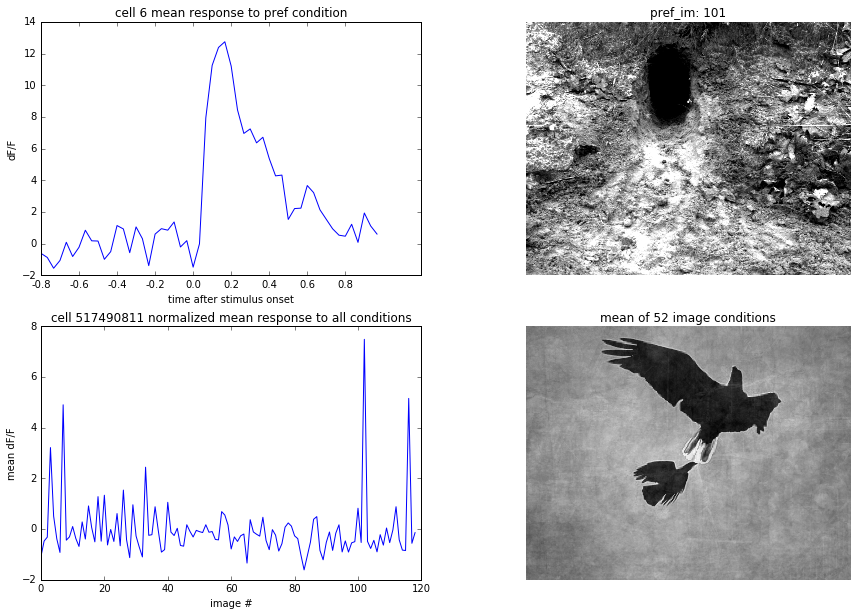

In [193]:
plot_ns_summary(responsive_cells[1],ns,images,frames_arr,images_arr,traces_arr,thresh=0.5,weighted=False)